# Histogram - Boxplots - segmentation

In [1]:
import os
# fix root path to save outputs
actual_path = os.path.abspath(os.getcwd())
list_root_path = actual_path.split('/')[:-1]
root_path = '/'.join(list_root_path)
os.chdir(root_path)
print('root path: ', root_path)

root path:  /Users/joseortega/Documents/GitHub/exploratory-data-analysis-ds


### 0. Package and load data

In [2]:
from sklearn.datasets import fetch_california_housing
import json
import pandas as pd
import numpy as np

# plotly
import plotly
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

#### load data example segmentation
In this example there are the possible segmentation of the data to select:
- segmentation by target. custom segmentation. Price_segments
- segmentation by feature house age. custom segmentation. HouseAge_segments
- segmentation by MedInc. quintile segmentation. quartile_MedInc

In [3]:
# read data
data = pd.read_pickle('data/data_segmentation.pkl')

# define column that indice the segmentation of the data
column_segment = 'Price' + '_segments' # feature used to segment and the suffix "_segments"

# define the other segments that not use in the example
segments_not_use = ['HouseAge_segments', 'quartile_MedInc']
data.drop(columns = segments_not_use, inplace = True)

data.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,Price,Price_segments
3130,4.8750,1.0,5.533333,1.000000,32.0,2.133333,35.08,-117.95,1.417,Low Price
19536,4.2500,1.0,20.125000,2.928571,402.0,3.589286,37.65,-120.93,1.892,Low Price
18972,5.2636,1.0,7.694030,1.279851,872.0,3.253731,38.23,-122.00,1.913,Low Price
12286,1.6250,1.0,3.000000,1.000000,8.0,4.000000,33.86,-116.95,0.550,Low Price
12077,6.2308,2.0,8.801008,1.373804,5964.0,3.004534,33.87,-117.64,2.579,Medium Price


### 1. codes to generate eda

In [4]:
list_columns = data.columns.tolist()

In [5]:
column_segment

'Price_segments'

#### stacked histogram

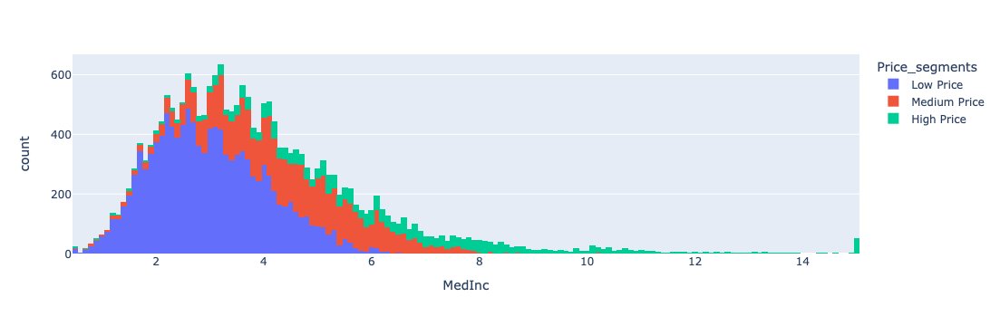

In [6]:
feature_x = list_columns[0]
fig = px.histogram(data, x = feature_x, color = column_segment)
fig.show()

#### stacked histogram v2

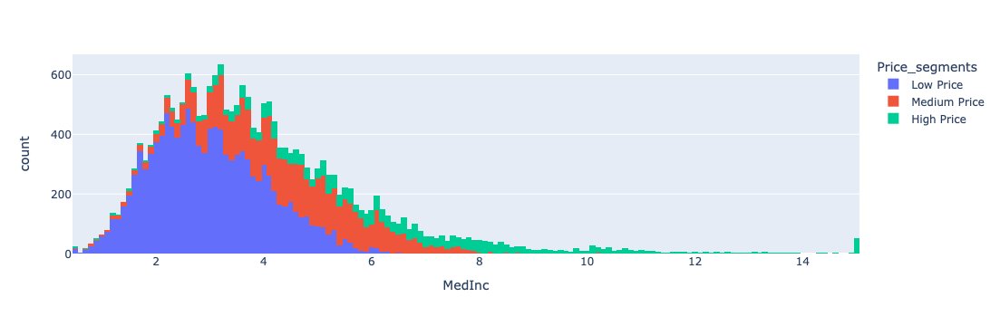

In [7]:
feature_x = list_columns[0]
fig = px.histogram(data, x = feature_x, color = column_segment)
fig.update_layout(barmode='stack')
fig.show()

#### Overlaid Histogram

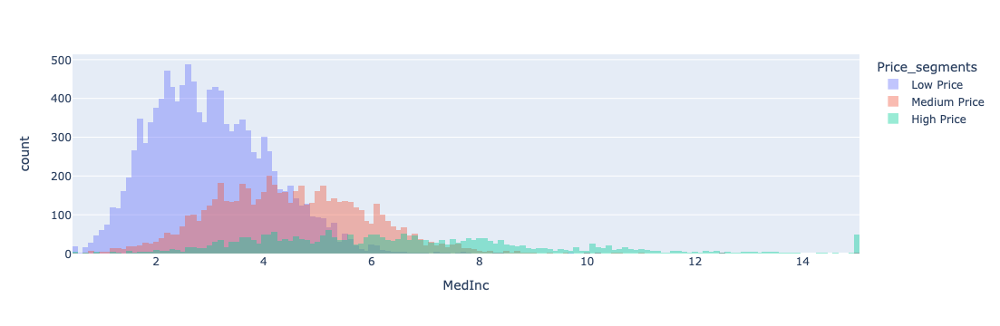

In [8]:
# Overlaid Histogram
feature_x = list_columns[0]
fig = px.histogram(data, x = feature_x, color = column_segment)

# update layout
fig.update_layout(barmode='overlay')
fig.update_traces(opacity=0.4)
fig.show()

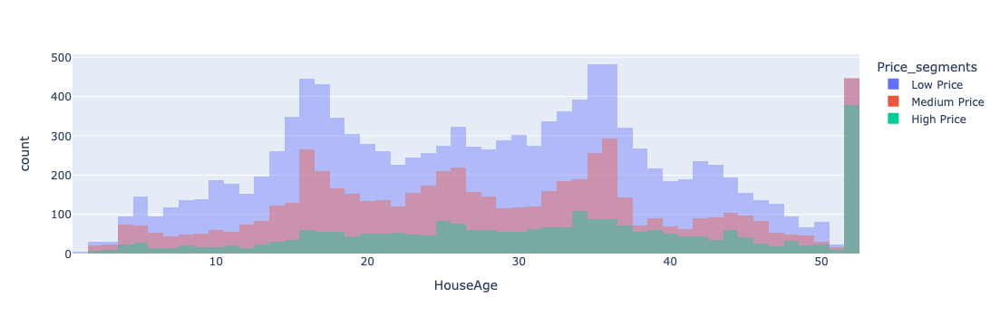

In [9]:
# Overlaid Histogram
feature_x = list_columns[1]
fig = px.histogram(data, x = feature_x, color = column_segment, barmode='overlay', opacity=0.4)
fig.show()

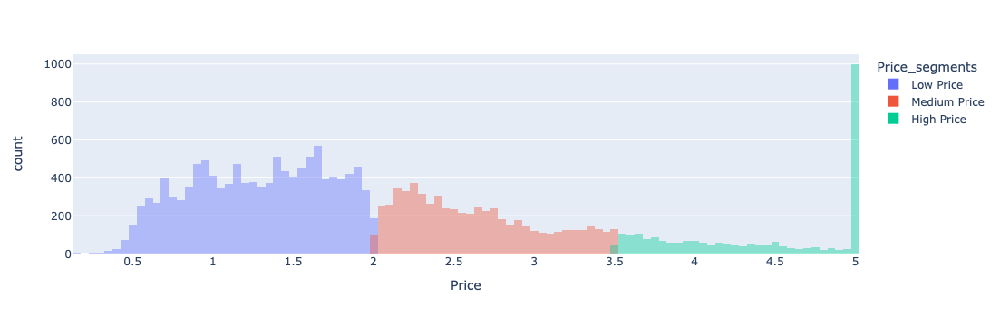

In [10]:
# Overlaid Histogram
feature_x = list_columns[-2]
fig = px.histogram(data, x = feature_x, color = column_segment, barmode='overlay', opacity=0.4)
fig.show()

#### boxplot

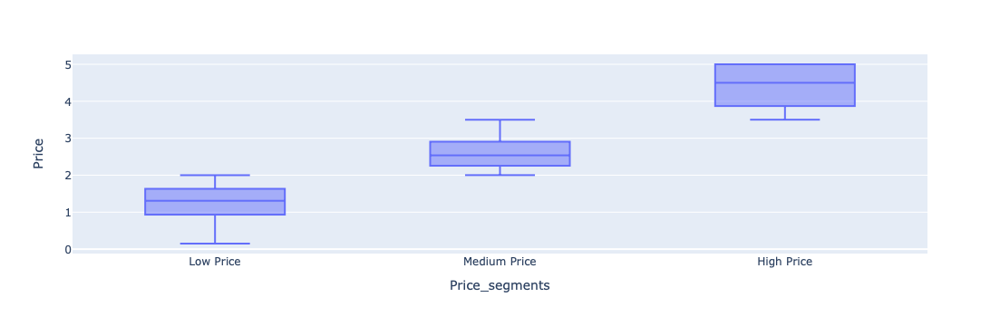

In [11]:
fig = px.box(data, x = column_segment, y = feature_x)
fig.show()

#### boxplot v2

In [12]:
### ORDENAR LOS DATOS ANTES DE PLOTEAR
data = data.sort_values(by = [column_segment])

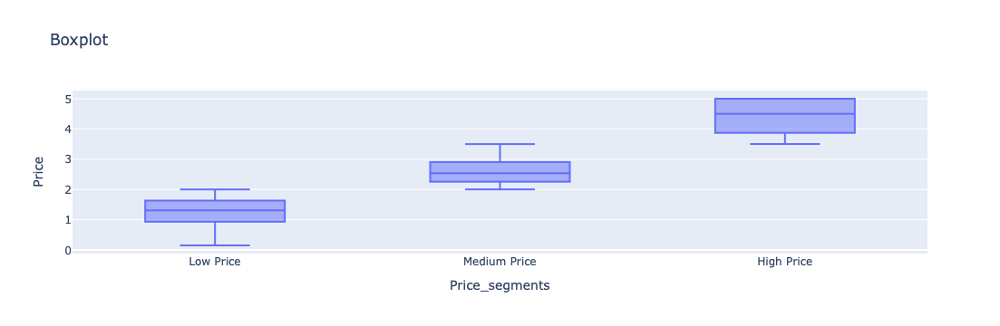

In [13]:
# Crear un boxplot con go
fig = go.Figure()

# Agregar boxplot
fig.add_trace(go.Box(x=data[column_segment], y=data[feature_x], name = f'Boxplot {feature_x} by segments {column_segment}'))

# Actualizar diseño
fig.update_layout(title_text='Boxplot',
                  xaxis_title=column_segment,
                  yaxis_title=feature_x)

# Mostrar la figura
fig.show()

### 2. sinthetize

In [14]:
def plot_individual_hist_segment(df, var_segment, feature_hist):
    """
    Plot individual hist
    Args
        df (dataframe): input dataframe
        varg_segment (string): name of the column in the input dataframe that indicate the differents segments in the data
        feature_hist (string): name of the feature in the input dataframe that will plot its histogram

    Return
        fig (figure plotly): fig of plotly with the plot generated
    """
    
    fig = px.histogram(df, x = feature_hist, color = var_segment, barmode='overlay', opacity=0.4)

    # update title
    fig.update_layout(
      title_text = f'Histogram: {feature_hist}',
      title_x = 0.5, # centrar titulo
      title_font = dict(size = 20)
    )
    return fig

In [15]:
def plot_histograms_segments_old(df, var_segment, number_columns = 2):
    """
    Plot multiple hist for each feature in the dataframe. Differents colors in the histogram according the segmentation in the data
    
    Args
        df (datafame): input dataframe
        varg_segment (string): name of the column in the input dataframe that indicate the differents segments in the data

    Return
        fig (figure plotly): fig of plotly with the plot generated
    """
    # get list features
    list_features = df.columns.tolist()


    # get number of rows (number row = number of data / number of columns)
    # (considering fixed the number of columns) 
    if (df.shape[1] % number_columns) != 0:
        number_rows = (df.shape[1] // number_columns) + 1 
    else:
        number_rows = (df.shape[1] // number_columns)


    ############################## 
    # Create los subplots
    fig = make_subplots(rows = number_rows, cols = number_columns, shared_xaxes=False, subplot_titles=list_features)

    # add each histogram
    for index_feature, feature in enumerate(list_features):

        # obtener índices en el subplot (en plotly los índices comienzan en 1, por lo que debe sumarse un 1 a los resultados obtenidos)
        row = (index_feature // number_columns) + 1
        column = (index_feature % number_columns) + 1
        
        # get histogram individual
        fig_aux = px.histogram(df, x = feature, color = var_segment, barmode='overlay', opacity=0.4)
        
        # add histogram to fig global
        for index in range(len(fig_aux.data)):
            fig.add_trace(fig_aux.data[index],
                row = row,
                col = column
            )

    
    # update layout
    fig.update_layout(height=len(list_features)*250, 
                      width=1600, 
                      title_text = "Histograms Segmentations",
                      title_x = 0.5, # centrar titulo
                    title_font = dict(size = 28)
                     )    
    return fig

In [16]:
def plot_histograms_segments(df, var_segment, number_columns = 2):
    """
    Plot multiple hist for each feature in the dataframe. Differents colors in the histogram according the segmentation in the data
    
    Args
        df (datafame): input dataframe
        varg_segment (string): name of the column in the input dataframe that indicate the differents segments in the data

    Return
        fig (figure plotly): fig of plotly with the plot generated
    """
    # get list features
    list_features = df.columns.tolist()


    # get name of each segment in a list
    unique_values_segments = df[var_segment].unique().tolist()
    unique_values_segments = list(filter(pd.notna, unique_values_segments)) # delete null values in segments
    unique_values_segments.sort()

    # get number of rows (number row = number of data / number of columns)
    # (considering fixed the number of columns) 
    if (df.shape[1] % number_columns) != 0:
        number_rows = (df.shape[1] // number_columns) + 1 
    else:
        number_rows = (df.shape[1] // number_columns)


    ############################## 
    # Create los subplots
    fig = make_subplots(rows = number_rows, cols = number_columns, shared_xaxes=False, subplot_titles=list_features)

    # add each histogram
    for index_feature, feature in enumerate(list_features):

        # obtener índices en el subplot (en plotly los índices comienzan en 1, por lo que debe sumarse un 1 a los resultados obtenidos)
        row = (index_feature // number_columns) + 1
        column = (index_feature % number_columns) + 1
        

        # histogram
        for segment in unique_values_segments:
            df_segment = df[df[var_segment] == segment]
            fig.add_trace(go.Histogram(x = df_segment[feature], 
                                       name = segment,
                                       opacity=0.4), 
                          row = row, col = column)

    
    # update layout
    fig.update_layout(height=len(list_features)*250, 
                      width=1600, 
                      title_text = "Histograms Segmentations",
                      title_x = 0.5, # centrar titulo
                    title_font = dict(size = 28),
                      barmode = 'stack'
                     )    
    return fig


def plot_boxplots_segments(df, var_segment, number_columns = 2):
    """
    Plot multiple boxplots for each feature in the dataframe. Differents colors in the histogram according the segmentation in the data
    
    Args
        df (datafame): input dataframe
        varg_segment (string): name of the column in the input dataframe that indicate the differents segments in the data

    Return
        fig (figure plotly): fig of plotly with the plot generated
    """
    # get list features
    list_features = df.columns.tolist()


    # get number of rows (number row = number of data / number of columns)
    # (considering fixed the number of columns) 
    if (df.shape[1] % number_columns) != 0:
        number_rows = (df.shape[1] // number_columns) + 1 
    else:
        number_rows = (df.shape[1] // number_columns)


    ############################## 
    # Create los subplots
    fig = make_subplots(rows = number_rows, cols = number_columns, shared_xaxes=False, subplot_titles=list_features)

    # add each boxplot
    for index_feature, feature in enumerate(list_features):

        # obtener índices en el subplot (en plotly los índices comienzan en 1, por lo que debe sumarse un 1 a los resultados obtenidos)
        row = (index_feature // number_columns) + 1
        column = (index_feature % number_columns) + 1
        
        # add trace boxplot
        #fig.add_trace(go.Box(x=df[var_segment], y=df[feature], name = f'Boxplot {feature} by segments {var_segment}'),
        fig.add_trace(go.Box(x=df[var_segment], y=df[feature]),
                row = row,
                col = column)
        
    # update layout
    fig.update_layout(height=len(list_features)*250, 
                      width=1600, 
                      title_text = "Boxplots Segmentations",
                      title_x = 0.5, # centrar titulo
                    title_font = dict(size = 28)
                     )
    return fig

#### run examples

In [17]:
data.sort_index(inplace = True)
data

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,Price,Price_segments
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526,High Price
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585,High Price
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521,High Price
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413,Medium Price
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422,Medium Price
...,...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781,Low Price
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771,Low Price
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923,Low Price
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847,Low Price


In [18]:
### ORDER DATA BEFORE PLOT
data = data.sort_values(by = [column_segment])
data

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,Price,Price_segments
20639,2.3886,16.0,5.254717,1.162264,1387.0,2.616981,39.37,-121.24,0.894,Low Price
10705,2.5685,26.0,4.517778,1.028889,618.0,1.373333,33.61,-117.72,0.804,Low Price
10706,2.4900,26.0,4.542808,1.063356,774.0,1.325342,33.61,-117.72,0.811,Low Price
10707,2.6848,26.0,4.594268,1.095023,888.0,1.339367,33.61,-117.71,0.741,Low Price
10708,2.3438,26.0,4.541833,1.095618,669.0,1.332669,33.61,-117.71,0.723,Low Price
...,...,...,...,...,...,...,...,...,...,...
13230,6.4559,16.0,7.641161,1.065963,1165.0,3.073879,34.15,-117.64,3.929,High Price
13229,8.5282,25.0,7.831050,1.107306,1284.0,2.931507,34.15,-117.66,3.601,High Price
13184,7.5839,13.0,8.268908,1.067227,364.0,3.058824,33.95,-117.75,4.269,High Price
14009,6.1309,52.0,6.578199,1.009479,513.0,2.431280,32.75,-117.19,4.116,High Price


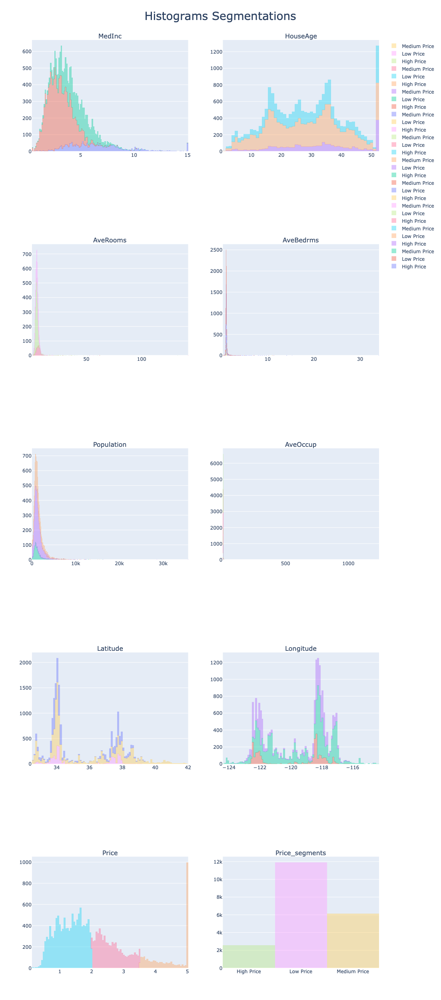

In [19]:
#### histograms

fig_hist_segments = plot_histograms_segments(df = data, 
                                             var_segment = column_segment, 
                                             number_columns = 2)

fig_hist_segments.write_html("output_eda/4_segmentation_analysis/histograms_segmentation.html")

fig_hist_segments.show()

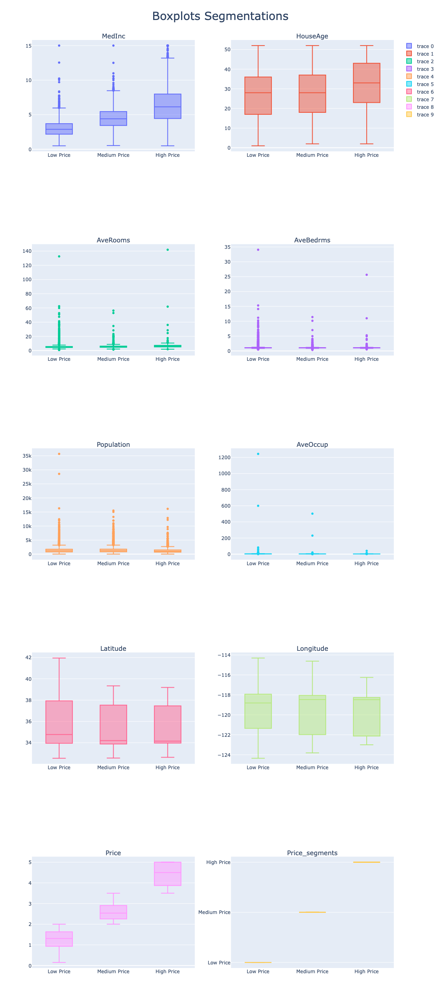

In [20]:
#### boxplots

fig_boxplots_segments = plot_boxplots_segments(df = data, 
                                             var_segment = column_segment, 
                                             number_columns = 2)

fig_boxplots_segments.write_html("output_eda/4_segmentation_analysis/boxplots_segmentation.html")

fig_boxplots_segments.show()

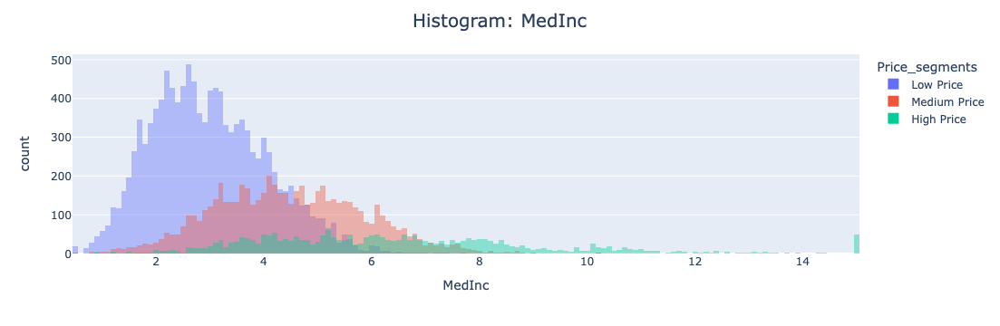

In [21]:
# individual hist
plot_individual_hist_segment(df = data, var_segment = column_segment, feature_hist = 'MedInc')